In [1]:
import os

from repath.utils.paths import project_root

test_dir = project_root() / "data" / "test_segment"

files = os.listdir(test_dir)

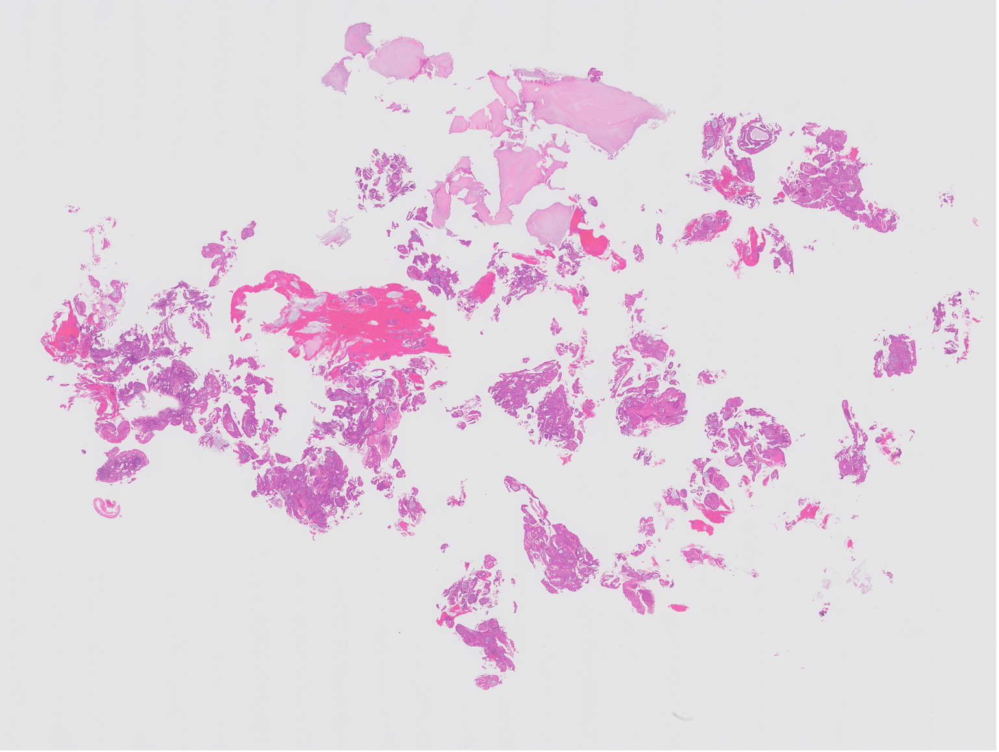

In [2]:
from PIL import Image

image = Image.open(test_dir / files[1])

half_size = (int(image.size[0] / 2), int(image.size[1] / 2))

image = image.resize(half_size)
image

In [3]:
def show_np(arr_in):
    return Image.fromarray(np.array(arr_in, dtype=np.uint8))

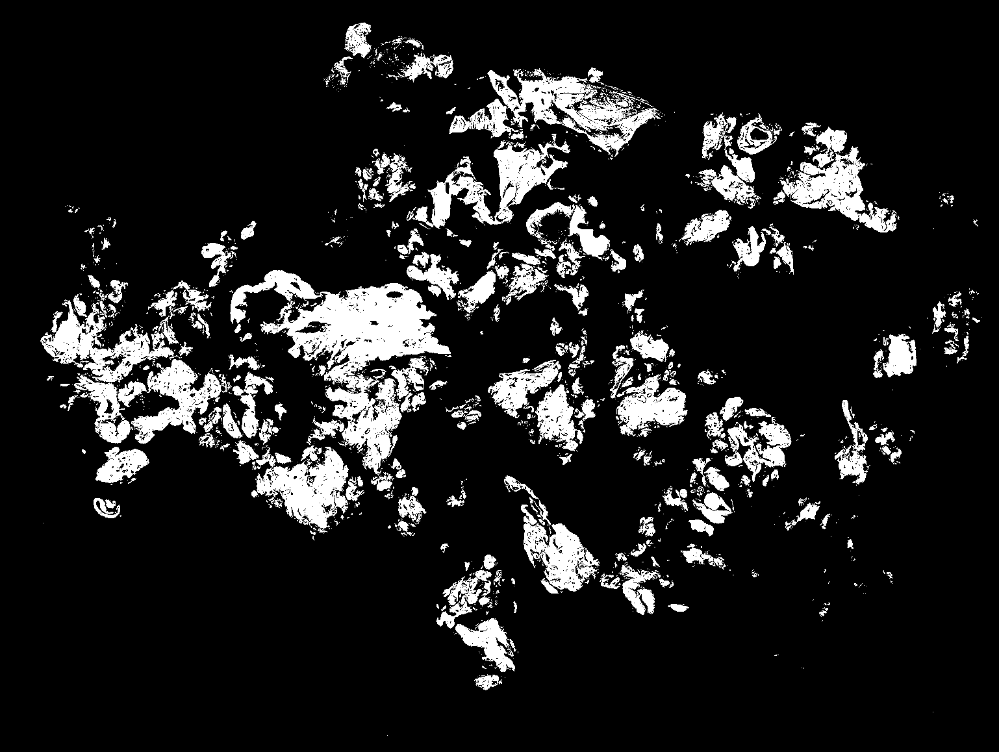

In [4]:
import numpy as np

from repath.preprocess.tissue_detection import TissueDetectorGreyScale, TissueDetectorOTSU

image_np = np.array(image)
tissue_detector = TissueDetectorOTSU()
tissue_mask = tissue_detector(image_np)
show_np(tissue_mask*255)

In [5]:
three_d_mask = np.expand_dims(tissue_mask, axis=-1)
three_d_mask = np.dstack((three_d_mask, three_d_mask, three_d_mask))
filtered_image = np.where(np.logical_not(three_d_mask), 255, image_np)

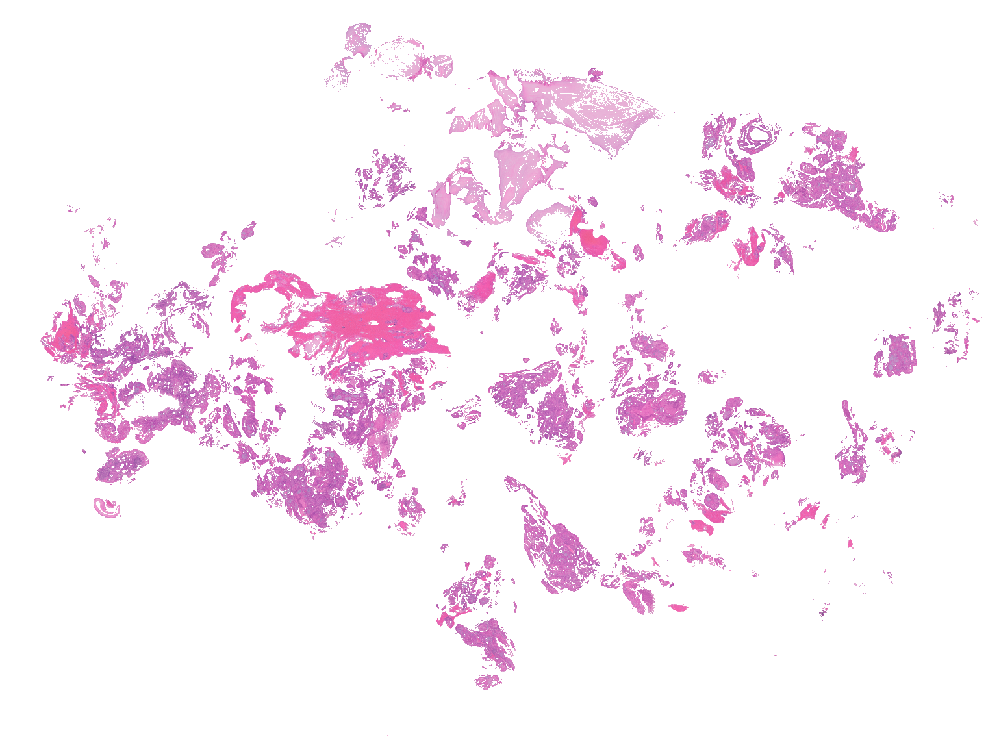

In [6]:
show_np(filtered_image)

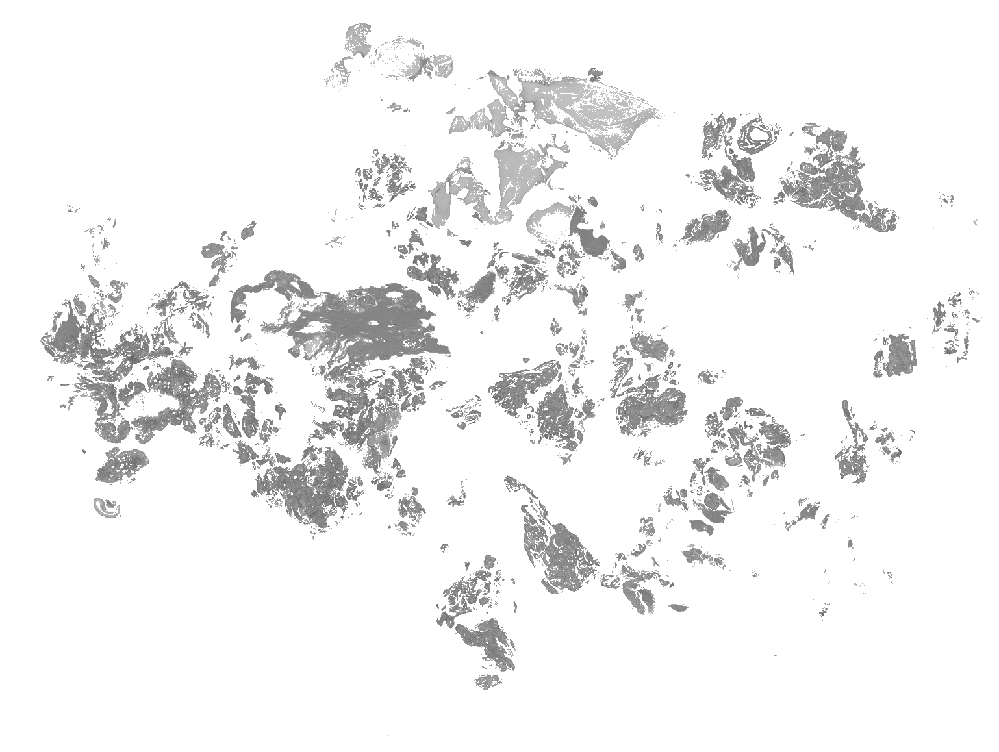

In [7]:
from skimage.color import rgb2gray

image_gs = rgb2gray(filtered_image)
show_np(image_gs*255)

## Active contours - not promising

Needs a initially specified starting snake, maybe too manual to get a good automatic result.

Need to specify if attracted to dark or light regions

Not good performance of finding outer edge using basic values.
Seems like it would need a lot of tuning to get something to work on outer edge let alone fine gradations of colour

In [8]:
from skimage.filters import gaussian
from skimage.segmentation import active_contour

s = np.linspace(0, 2*np.pi, 400)
r = 375 + 200*np.sin(s)
c = 275 + 200*np.cos(s)
init = np.array([r, c]).T

snake = active_contour(gaussian(filtered_image, 3),
                       init, alpha=0.005, beta=20, gamma=0.001, w_line=-0.2)


/home/ubuntu/anaconda3/envs/repath/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: Images with dimensions (M, N, 3) are interpreted as 2D+RGB by default. Use `multichannel=False` to interpret as 3D image with last dimension of length 3.
  if __name__ == '__main__':
/home/ubuntu/anaconda3/envs/repath/lib/python3.6/site-packages/ipykernel_launcher.py:10: FutureWarning: The coordinates used by `active_contour` will change from xy coordinates (transposed from image dimensions) to rc coordinates in scikit-image 0.18. Set `coordinates='rc'` to silence this warning. `coordinates='xy'` will restore the old behavior until 0.18, but will stop working thereafter.
  # Remove the CWD from sys.path while we load stuff.


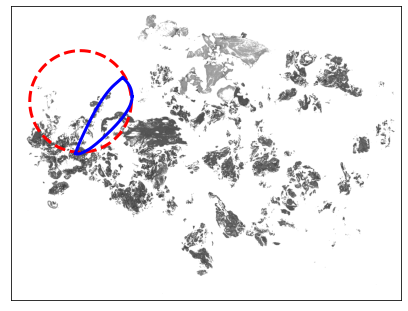

In [9]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(7, 7))
ax.imshow(image_gs, cmap=plt.cm.gray)
ax.plot(init[:, 1], init[:, 0], '--r', lw=3)
ax.plot(snake[:, 1], snake[:, 0], '-b', lw=3)
ax.set_xticks([]), ax.set_yticks([])
ax.axis([0, image_gs.shape[1], image_gs.shape[0], 0])

plt.show()

## Chan Vese segmentation - no use

Only works on greyscale 

Only returns a true false segmentation 

In [10]:
from skimage.segmentation import chan_vese

# Feel free to play around with the parameters to see how they impact the result

cv = chan_vese(image_gs, mu=0.25, lambda1=1, lambda2=1, tol=1e-3, max_iter=200,
               dt=0.5, init_level_set="checkerboard", extended_output=True)

segments_cv = cv[0]
levset_cv = cv[1]

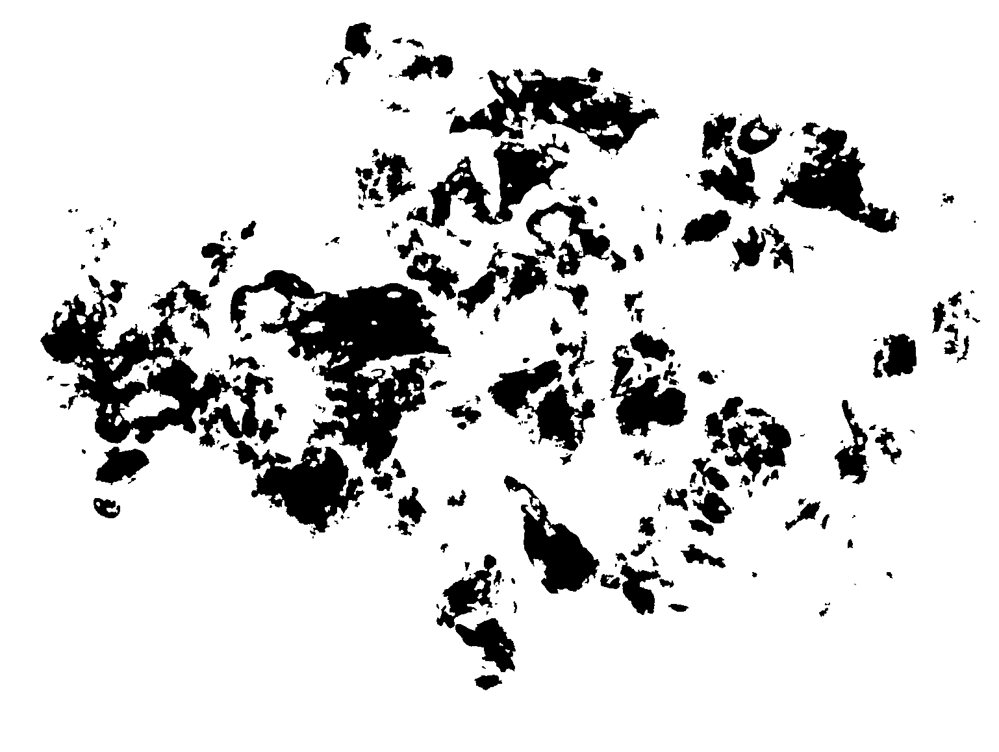

In [11]:
show_np(segments_cv*255)

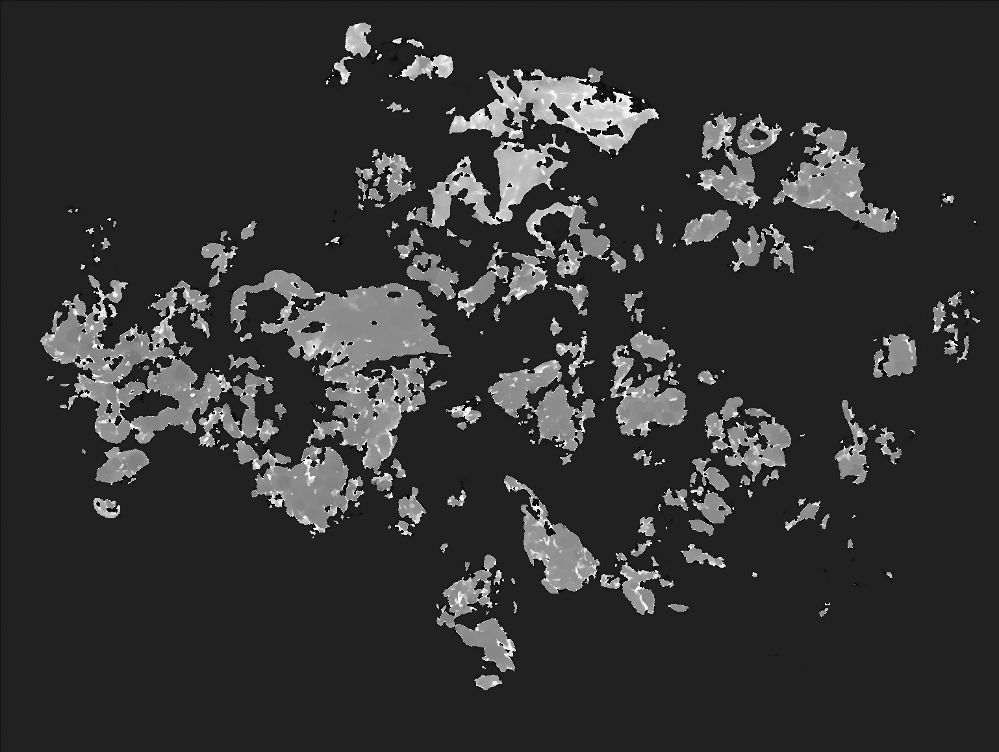

In [12]:
show_np(levset_cv*255)

## Checkerboard level set - tool not a segmentation technique

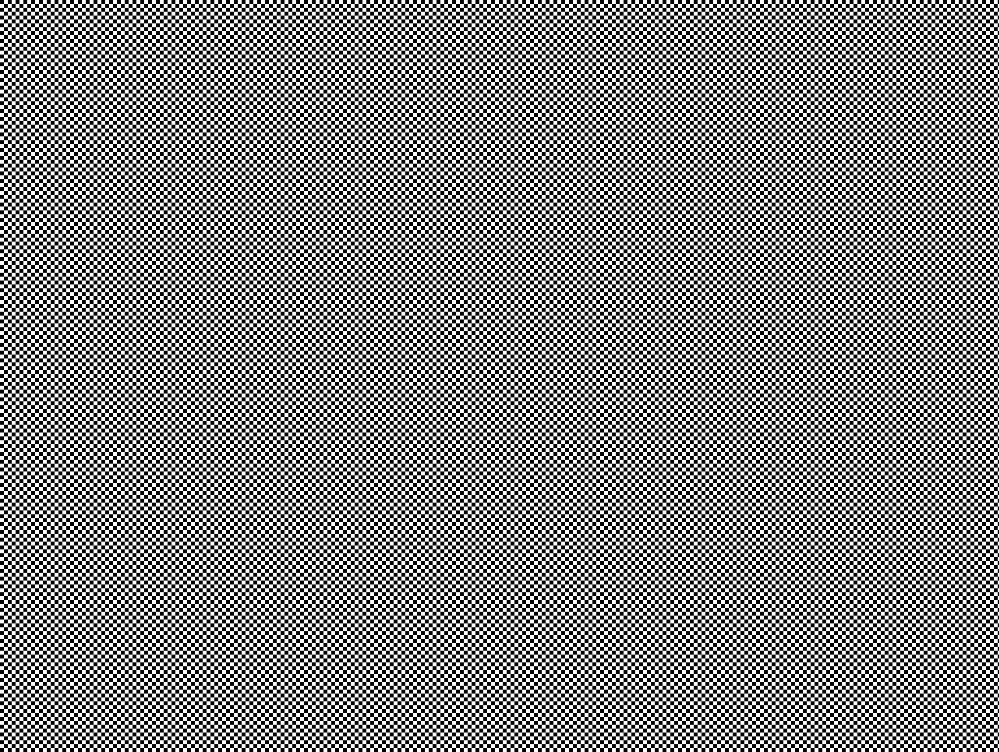

In [13]:
from skimage.segmentation import checkerboard_level_set

init_ls = checkerboard_level_set(image_gs.shape, 6)

show_np(init_ls*255)

Circle level set - tool not a segmentation technique

/home/ubuntu/anaconda3/envs/repath/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: circle_level_set is deprecated in favor of disk_level_set.circle_level_set will be removed in version 0.19
  This is separate from the ipykernel package so we can avoid doing imports until


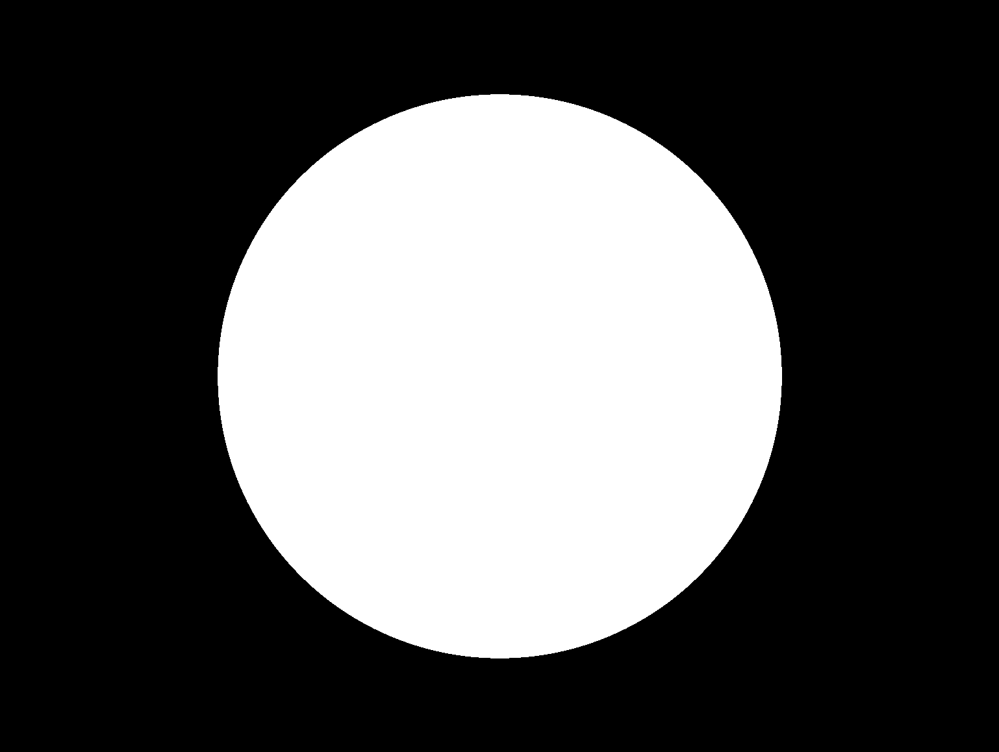

In [14]:
from skimage.segmentation import circle_level_set

init_ls = circle_level_set(image_gs.shape)

show_np(init_ls*255)

## Clear border - tool not a segmentation technique

Removes segments on edge of image

In [15]:
from skimage.segmentation import clear_border

import matplotlib.pyplot as plt
import matplotlib.patches as mpatches

from skimage import data
from skimage.filters import threshold_otsu
from skimage.segmentation import clear_border
from skimage.measure import label, regionprops
from skimage.morphology import closing, square
from skimage.color import label2rgb


image = data.coins()[50:-50, 50:-50]

# apply threshold
thresh = threshold_otsu(image)
bw = closing(image > thresh, square(3))

# remove artifacts connected to image border
cleared = clear_border(bw)

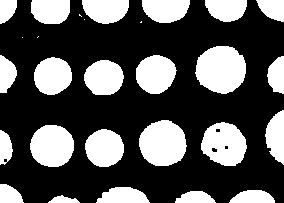

In [16]:
show_np(bw*255)

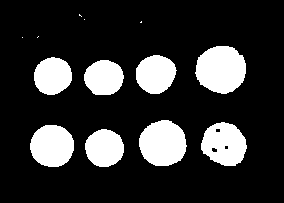

In [17]:
show_np(cleared*255)

## disk_level_set - tool not a segmentation

Disk level set cannot import might be a version issue

In [18]:
#from skimage.segmentation import disk_level_set

#init_ls = disk_level_set(image_gs.shape)

#show_np(init_ls*255)

## expand labels - tool not a segmentation

Expand labels cannot import might be a version issue

In [19]:
#from skimage.segmentation import expand_labels

#expanded = expand_labels(tissue_mask, distance=10)

#show_np(expanded)

## Felzenszwalb segmentation - looks promising

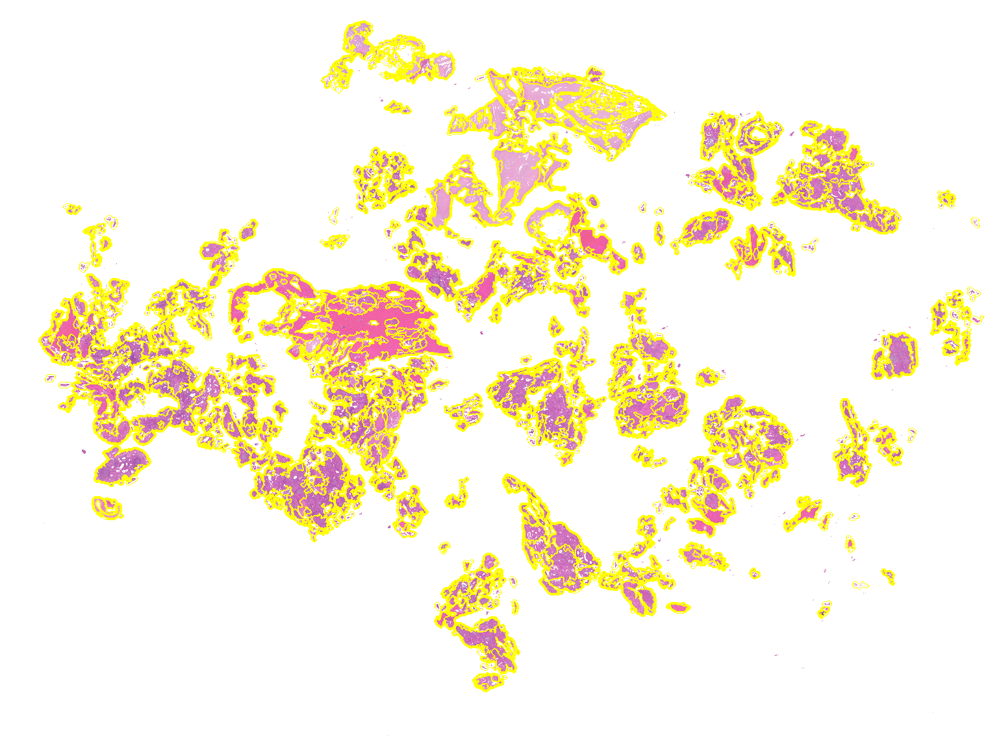

In [20]:
from skimage.segmentation import felzenszwalb
from skimage.segmentation import mark_boundaries

segments_fz = felzenszwalb(filtered_image, scale=100, sigma=0.5, min_size=50)
image_fz = mark_boundaries(filtered_image, segments_fz)

show_np(image_fz*255)

## find boundaries and mark boundaries - a tool not a segmentation

find boundaries creates a mask of lines where segments meet.

mark boundaries draws the lines on the original image

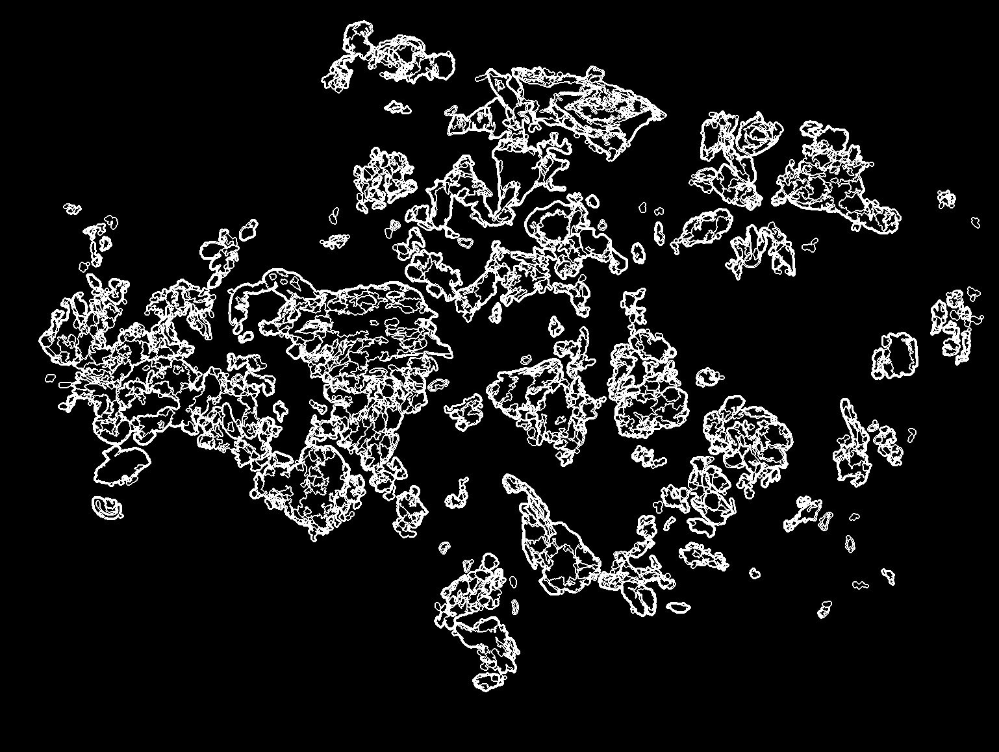

In [21]:
from skimage.segmentation import find_boundaries

boundaries = find_boundaries(segments_fz)

show_np(boundaries*255)

## flood and flood fill - not promising

Flood fill changes the original image. flood creates a mask of the flood area

Would require a lot of guesswork to get good starting points for flooding

May be useful somewhere in a pipeline

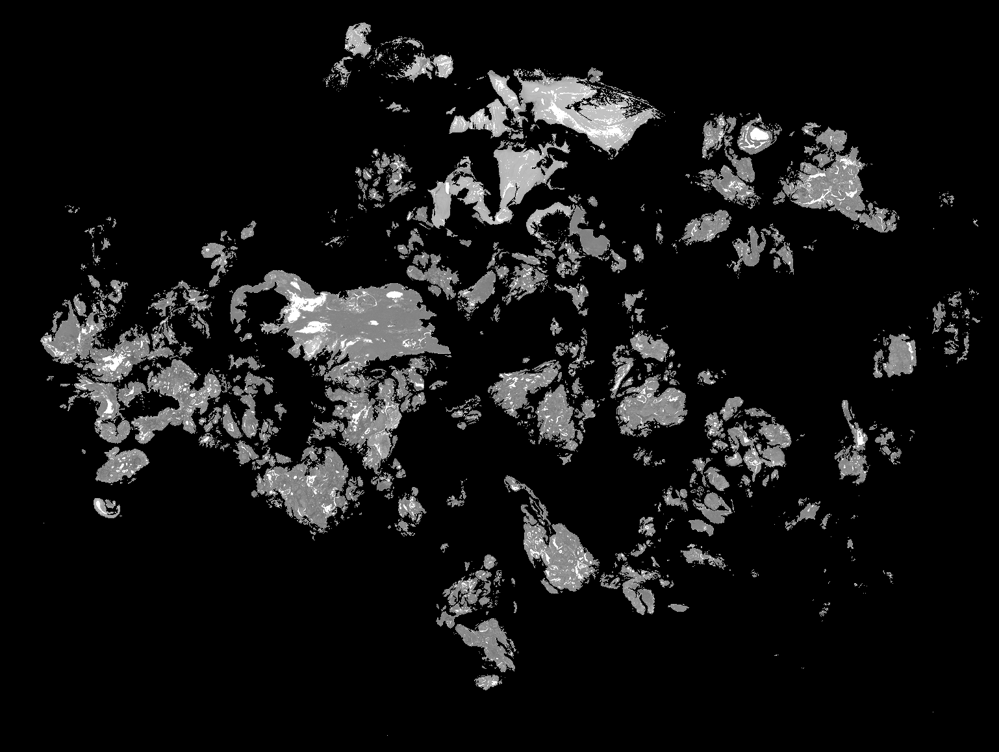

In [22]:
from skimage.segmentation import flood, flood_fill

ff_im = flood_fill(image_gs, (350, 275), 0, tolerance=0.15)

show_np(ff_im*255)

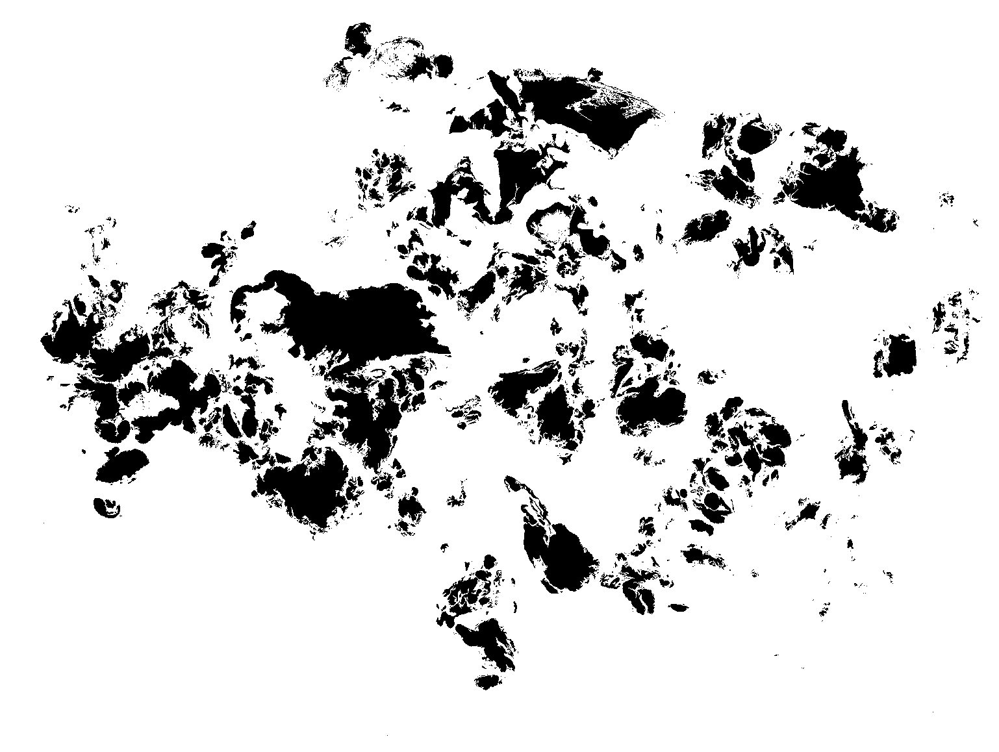

In [23]:
f_mask = flood(image_gs, (350, 275), tolerance=0.15)
show_np(f_mask*255)

## Inverse gaussian gradient

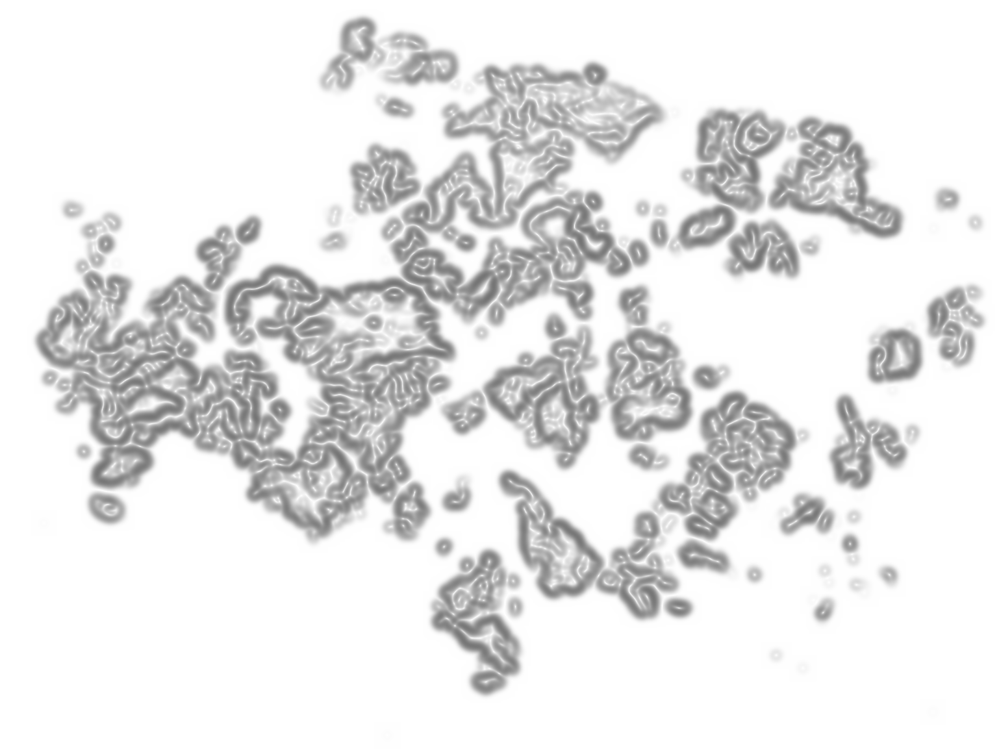

In [24]:
from skimage.segmentation import inverse_gaussian_gradient

gimage = inverse_gaussian_gradient(image_gs)

show_np(gimage*255)

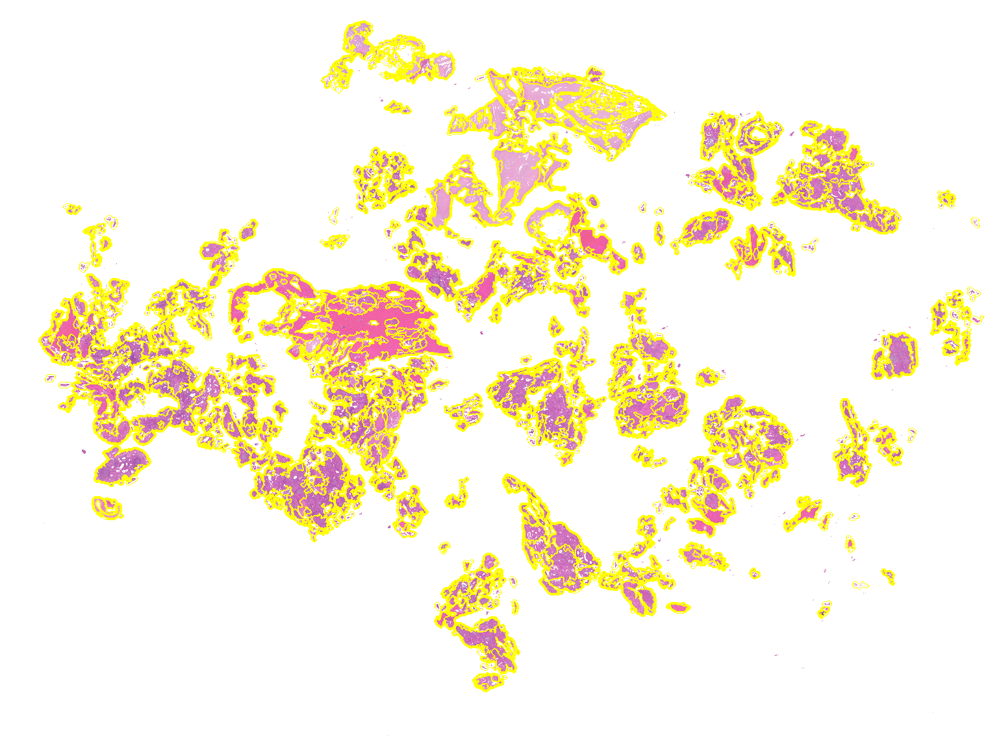

In [25]:
segments_fz_g = felzenszwalb(gimage, scale=100, sigma=0.5, min_size=50)
image_fz_g = mark_boundaries(filtered_image, segments_fz)

show_np(image_fz_g*255)

## Join segmentations

joins two segments, pixels are considered to be int he same segment if they are int he same segment in both segmentations

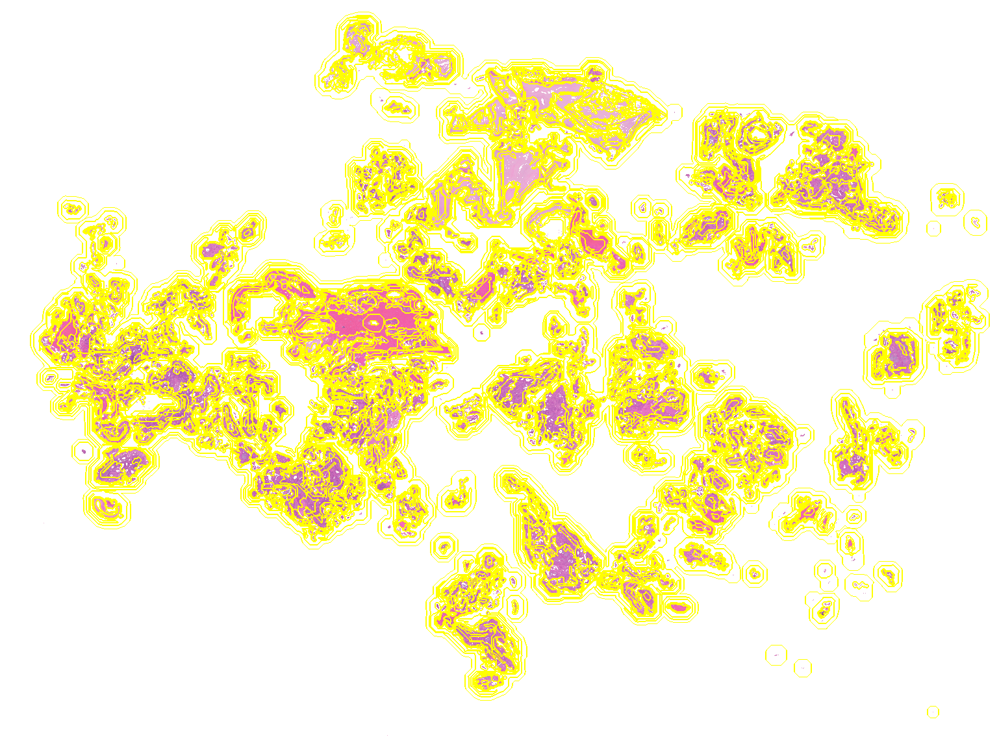

In [26]:
from skimage.segmentation import join_segmentations

segments_join = join_segmentations(segments_fz, segments_fz_g)

image_join = mark_boundaries(filtered_image, segments_join)

show_np(image_join*255)

## Morphological Chan Vese - not promising

Can only return true and false

In [27]:
from skimage.segmentation import morphological_chan_vese

def store_evolution_in(lst):
    """Returns a callback function to store the evolution of the level sets in
    the given list.
    """

    def _store(x):
        lst.append(np.copy(x))

    return _store


# Initial level set
init_ls_mcv = checkerboard_level_set(image_gs.shape, 6)

# List with intermediate results for plotting the evolution
evolution = []
callback = store_evolution_in(evolution)
ls = morphological_chan_vese(image_gs, 3, init_level_set=init_ls_mcv, smoothing=2,
                             iter_callback=callback)

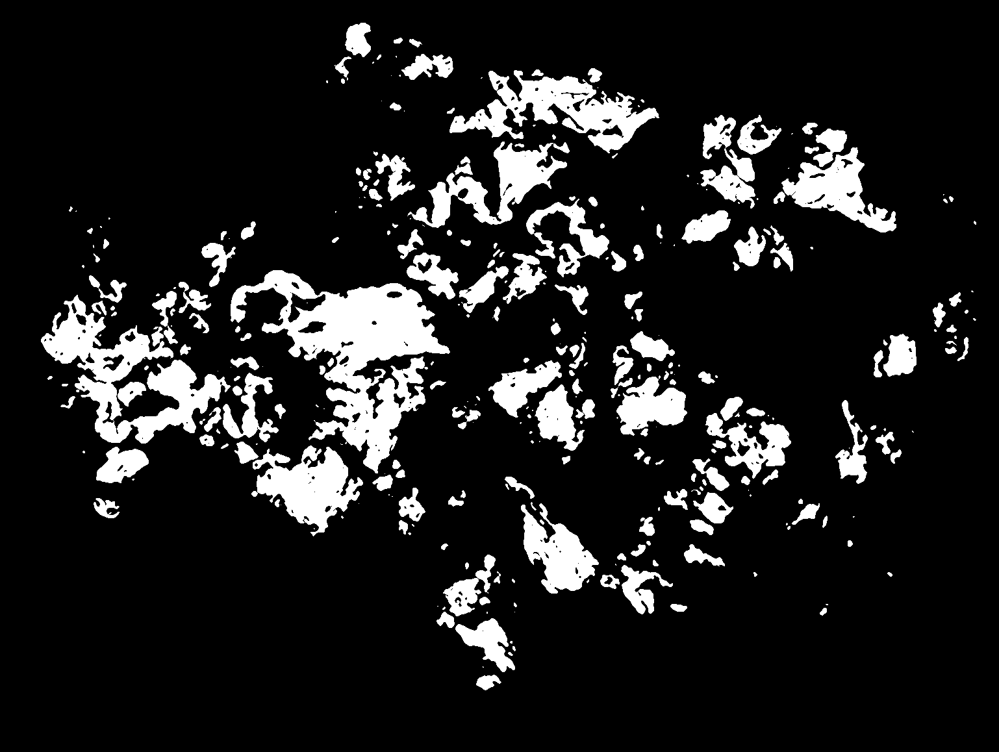

In [28]:
show_np(ls*255)

## Morphological geodesic active contour - not promising

Also only returns true and false

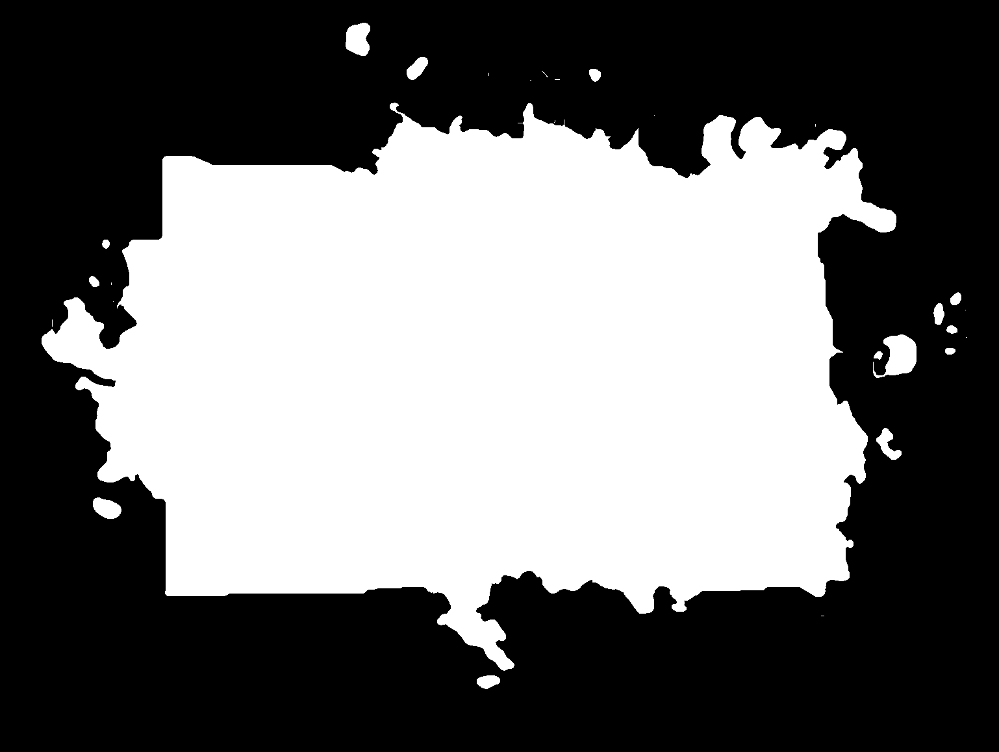

In [29]:
from skimage.segmentation import (morphological_chan_vese,
                                  morphological_geodesic_active_contour,
                                  inverse_gaussian_gradient,
                                  checkerboard_level_set)


# Morphological GAC
gimage = inverse_gaussian_gradient(image_gs)

# Initial level set
init_ls = np.zeros(image_gs.shape, dtype=np.int8)
init_ls[10:-10, 10:-10] = 1
# List with intermediate results for plotting the evolution
evolution = []
callback = store_evolution_in(evolution)
ls = morphological_geodesic_active_contour(gimage, 230, init_ls,
                                           smoothing=1, balloon=-1,
                                           threshold=0.69,
                                           iter_callback=callback)

show_np(ls*255)

## Quickshift clustering - possible

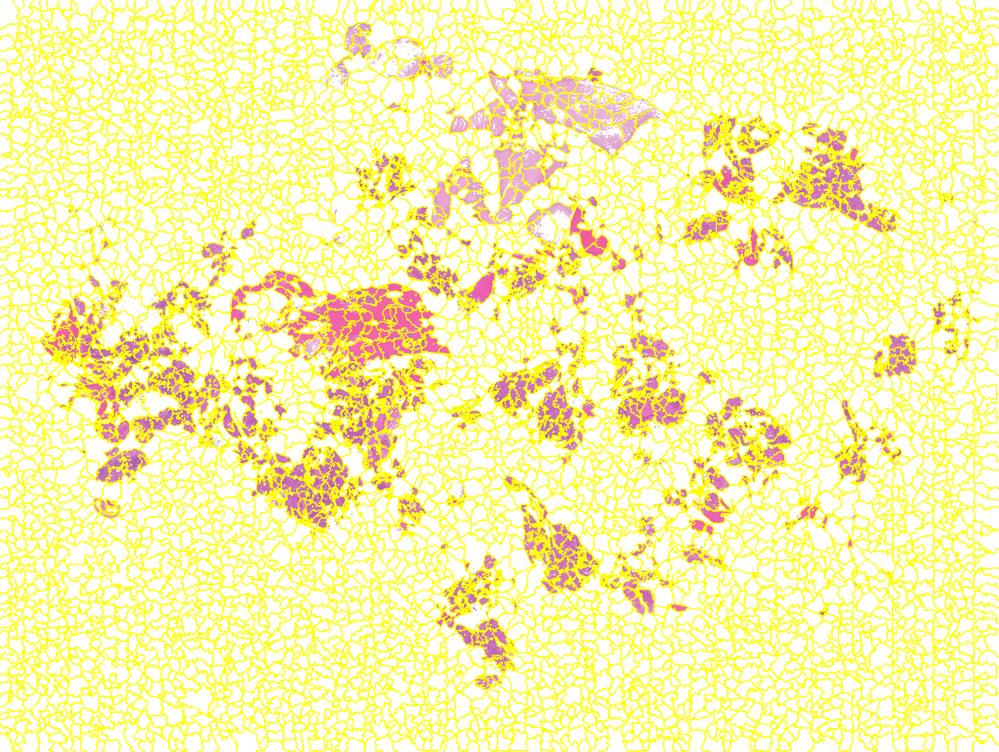

In [30]:
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed

segments_quick = quickshift(image_np, kernel_size=3, max_dist=6, ratio=0.5)
image_quick = mark_boundaries(filtered_image, segments_quick)

show_np(image_quick*255)

## Random walker - not promising

Should deal better with noisy images might be needs a lot of tweaking and understanding to work out

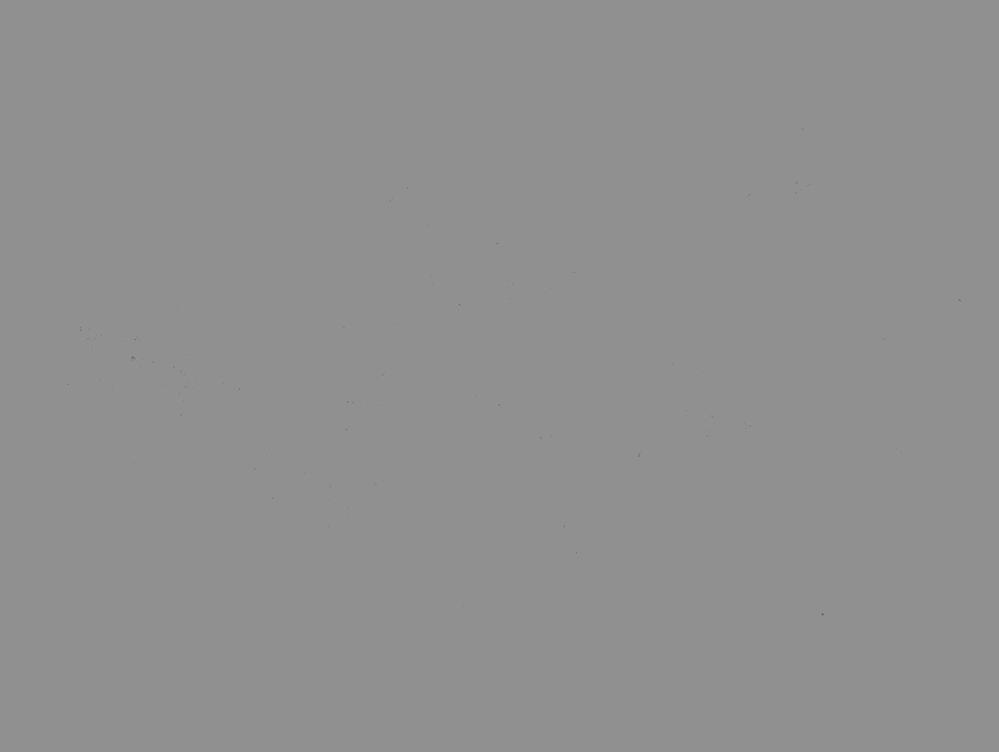

In [31]:
from skimage.segmentation import random_walker

# The range of the binary image spans over (-1, 1).
# We choose the hottest and the coldest pixels as markers.
markers = np.zeros(image_gs.shape, dtype=np.uint)
markers[image_gs < 0.4] = 1
markers[np.logical_and(image_gs < 0.99, image_gs > 0.8)] = 2

# Run random walker algorithm
labels = random_walker(image_gs, markers, beta=10, mode='bf')

show_np(labels*100)

## relabel sequential - tool not segmentation

In [32]:
from skimage.segmentation import relabel_sequential
label_field = np.array([1, 1, 5, 5, 8, 99, 42])
relab, fw, inv = relabel_sequential(label_field)
relab

array([1, 1, 2, 2, 3, 5, 4])

## SLIC segmentation - promising

k means clustering based

/home/ubuntu/anaconda3/envs/repath/lib/python3.6/site-packages/ipykernel_launcher.py:3: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.
  This is separate from the ipykernel package so we can avoid doing imports until


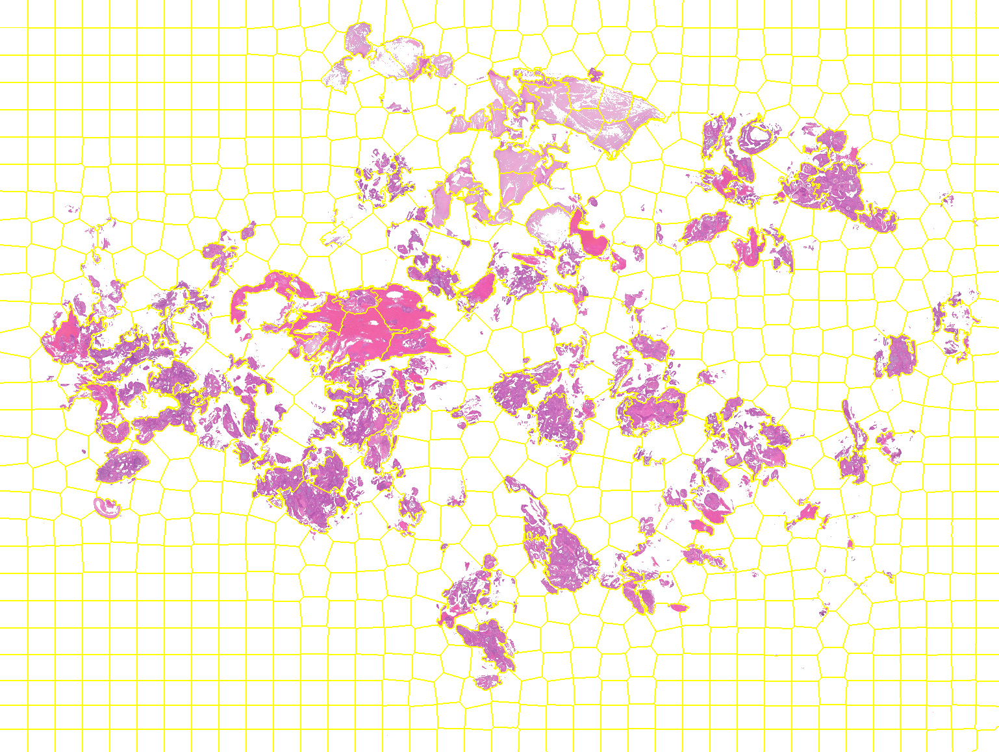

In [33]:
from skimage.segmentation import felzenszwalb, slic, quickshift, watershed

segments_slic = slic(image_np, n_segments=1000, compactness=10, sigma=1)
image_slic = mark_boundaries(filtered_image, segments_slic)

Image.fromarray(np.array(image_slic*255, dtype=np.uint8))

## Watershed segmentation - promising

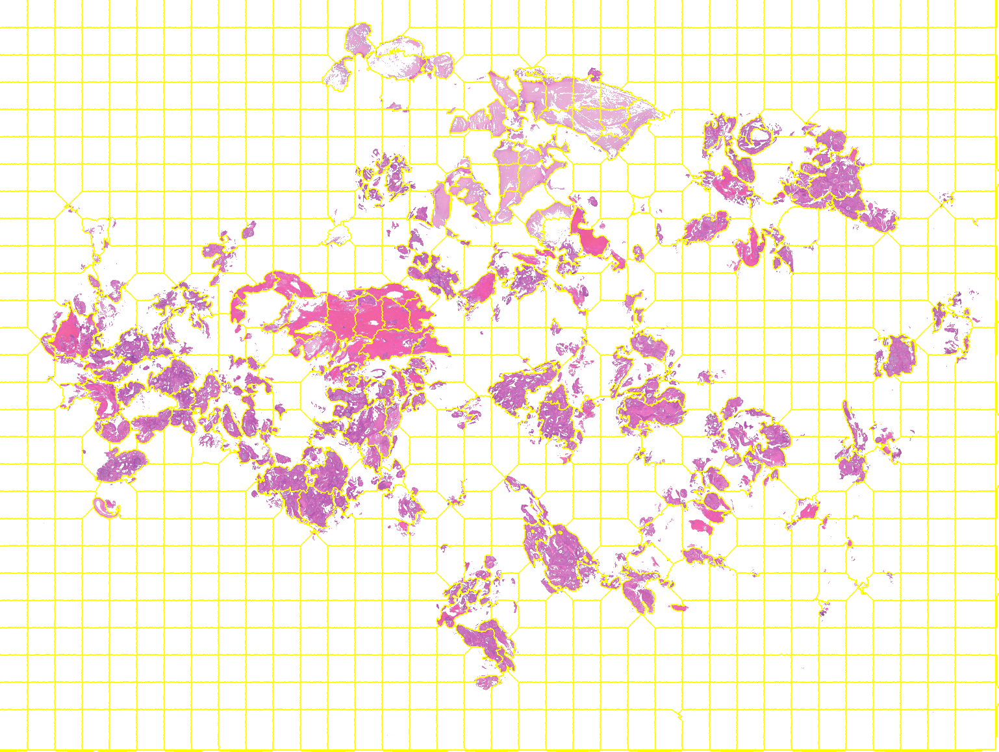

In [34]:
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb

gradient = sobel(rgb2gray(image_np))
segments_watershed_compact = watershed(gradient, markers=1000, compactness=0.001)
image_wsc = mark_boundaries(filtered_image, segments_watershed_compact)

show_np(image_wsc*255)

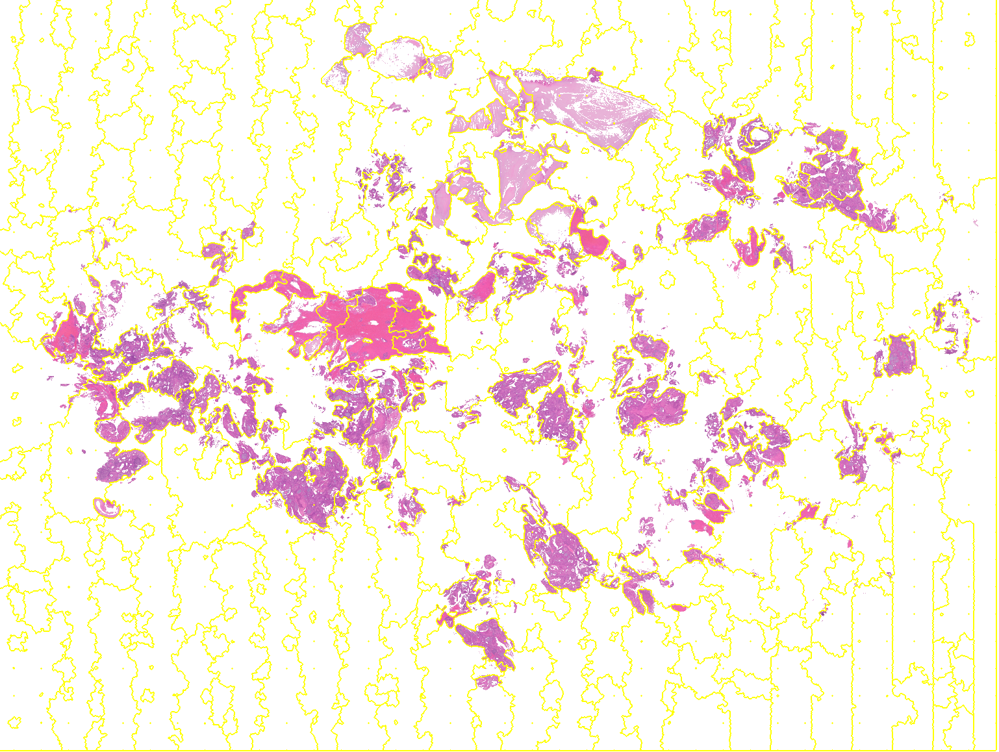

In [35]:
segments_watershed = watershed(gradient, markers=1000, compactness=0)
image_ws = mark_boundaries(filtered_image, segments_watershed)

show_np(image_ws*255)

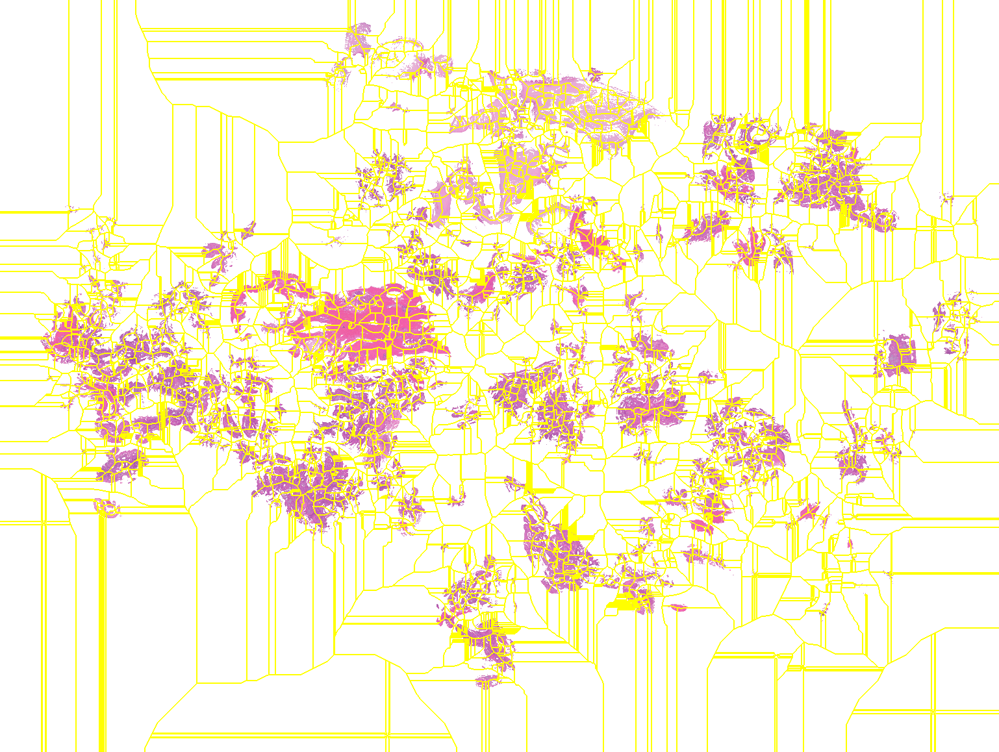

In [36]:
segments_watershed_g = watershed(gimage, compactness=0)
image_ws_g = mark_boundaries(filtered_image, segments_watershed_g)

show_np(image_ws_g*255)

## Region adjacency graph colour merging from SLIC

/home/ubuntu/anaconda3/envs/repath/lib/python3.6/site-packages/ipykernel_launcher.py:50: FutureWarning: skimage.measure.label's indexing starts from 0. In future version it will start from 1. To disable this warning, explicitely set the `start_label` parameter to 1.


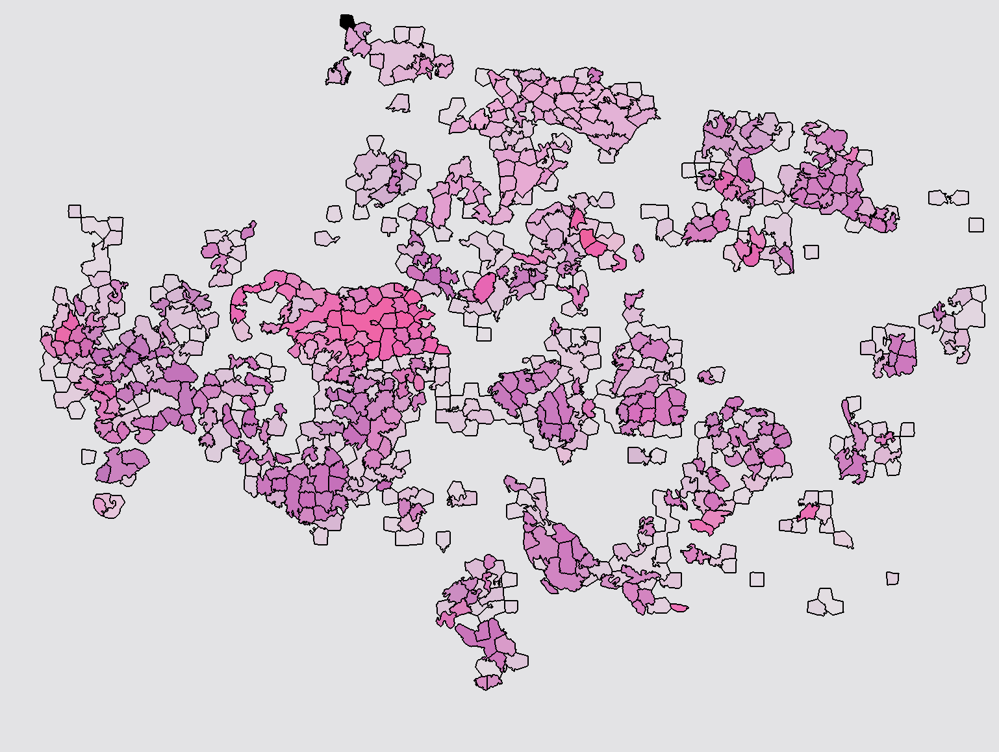

In [37]:
from skimage import data, io, segmentation, color
from skimage.future import graph
import numpy as np


def _weight_mean_color(graph, src, dst, n):
    """Callback to handle merging nodes by recomputing mean color.

    The method expects that the mean color of `dst` is already computed.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    n : int
        A neighbor of `src` or `dst` or both.

    Returns
    -------
    data : dict
        A dictionary with the `"weight"` attribute set as the absolute
        difference of the mean color between node `dst` and `n`.
    """

    diff = graph.nodes[dst]['mean color'] - graph.nodes[n]['mean color']
    diff = np.linalg.norm(diff)
    return {'weight': diff}


def merge_mean_color(graph, src, dst):
    """Callback called before merging two nodes of a mean color distance graph.

    This method computes the mean color of `dst`.

    Parameters
    ----------
    graph : RAG
        The graph under consideration.
    src, dst : int
        The vertices in `graph` to be merged.
    """
    graph.nodes[dst]['total color'] += graph.nodes[src]['total color']
    graph.nodes[dst]['pixel count'] += graph.nodes[src]['pixel count']
    graph.nodes[dst]['mean color'] = (graph.nodes[dst]['total color'] /
                                      graph.nodes[dst]['pixel count'])


labels = segmentation.slic(filtered_image, compactness=30, n_segments=4000)
g = graph.rag_mean_color(filtered_image, labels)

labels2 = graph.merge_hierarchical(labels, g, thresh=5, rag_copy=False,
                                   in_place_merge=True,
                                   merge_func=merge_mean_color,
                                   weight_func=_weight_mean_color)

out = color.label2rgb(labels2, image_np, kind='avg', bg_label=0)
out = mark_boundaries(out, labels2, (0, 0, 0))
show_np(out*255)

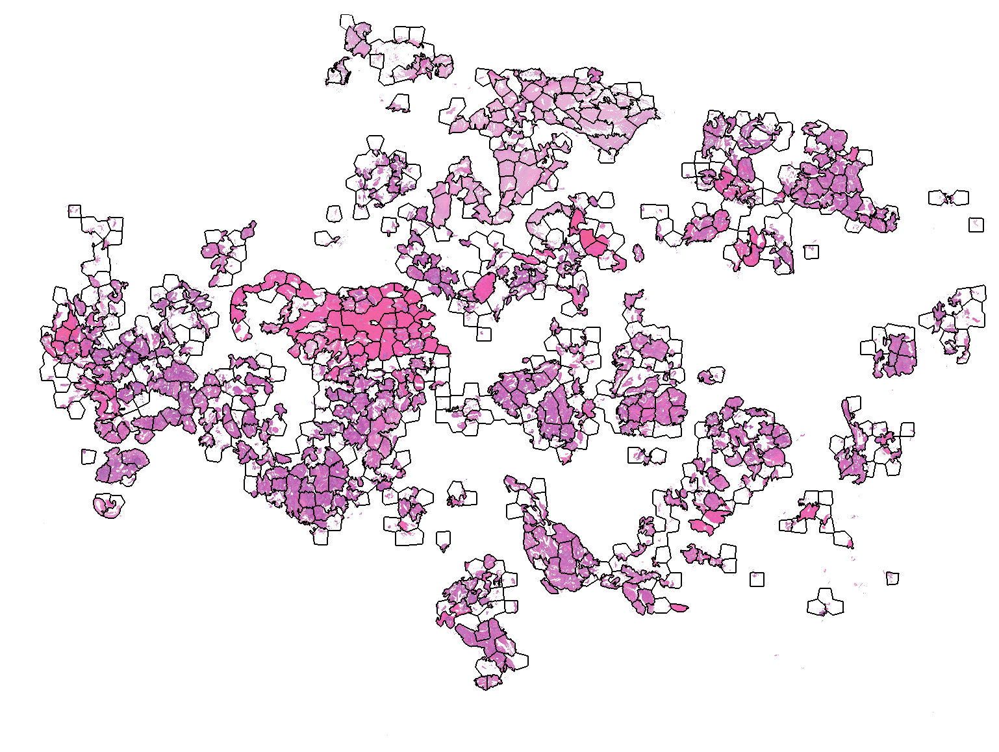

In [38]:
image_out = mark_boundaries(filtered_image, labels2, (255, 255, 0))
show_np(image_out*255)

In [39]:
#### Try on a watershed segmentation

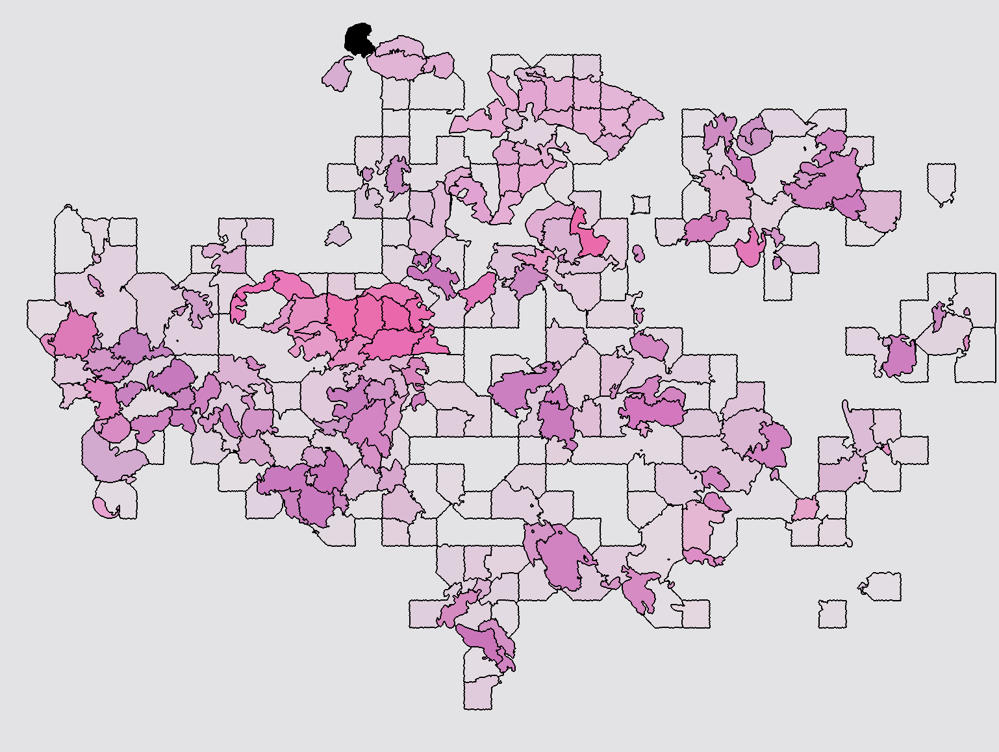

In [40]:
gw = graph.rag_mean_color(filtered_image, segments_watershed_compact)

labels_w = graph.merge_hierarchical(segments_watershed_compact, gw, thresh=2, rag_copy=False,
                                   in_place_merge=True,
                                   merge_func=merge_mean_color,
                                   weight_func=_weight_mean_color)

out_w = color.label2rgb(labels_w, image_np, kind='avg', bg_label=0)
out_w = mark_boundaries(out_w, labels_w, (0, 0, 0))
show_np(out_w*255)

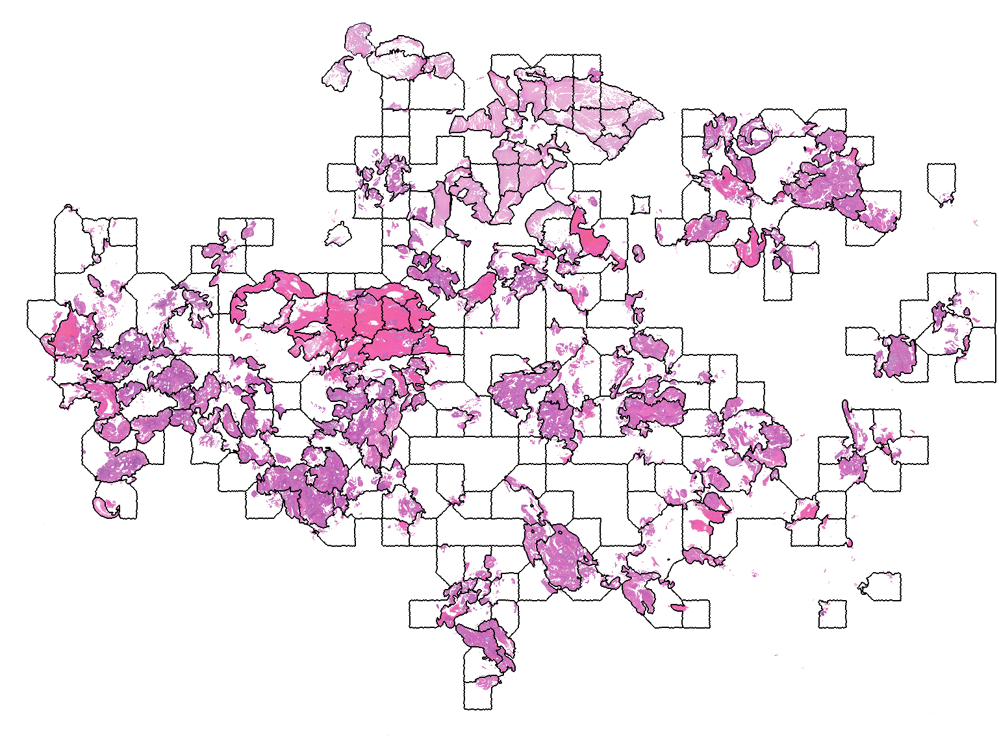

In [41]:
image_out_w = mark_boundaries(filtered_image, labels_w, (255, 255, 0))
show_np(image_out_w*255)

## Evaluating segmentation example

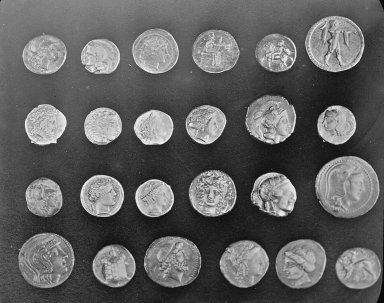

In [42]:
image = data.coins()

show_np(image)

#### Artificially create a "true" segmentation to test against

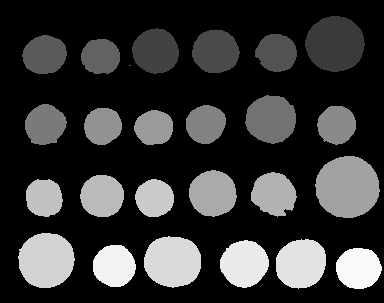

In [43]:
from scipy import ndimage as ndi

elevation_map = sobel(image)
markers = np.zeros_like(image)
markers[image < 30] = 1
markers[image > 150] = 2
im_true = watershed(elevation_map, markers)
im_true = ndi.label(ndi.binary_fill_holes(im_true - 1))[0]

show_np(np.where(im_true > 0, im_true*8+50, 0))

#### Create two segmentations to test

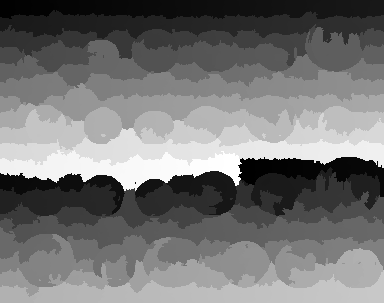

In [44]:
edges1 = sobel(image)
im_test1 = watershed(edges1, markers=468, compactness=0.001)

show_np(im_test1)

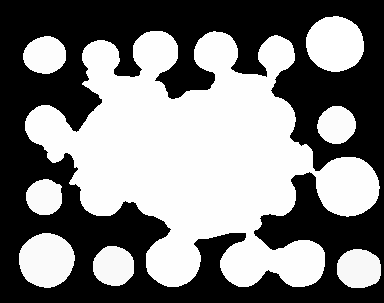

In [45]:
from skimage.util import img_as_float

image = img_as_float(image)
gradient = inverse_gaussian_gradient(image)
init_ls = np.zeros(image.shape, dtype=np.int8)
init_ls[10:-10, 10:-10] = 1
im_test2 = morphological_geodesic_active_contour(gradient, iterations=100,
                                                 init_level_set=init_ls,
                                                 smoothing=1, balloon=-1,
                                                 threshold=0.69)
im_test2 = label(im_test2)
show_np(im_test2*255)

In [46]:
from skimage.metrics import adapted_rand_error, variation_of_information

error1, precision1, recall1 = adapted_rand_error(im_true, im_test1)
splits1, merges1 = variation_of_information(im_true, im_test1)
f'error: {error1}, precision: {precision1}, recall: {recall1}, splits: {splits1}, merges: {merges1}'



'error: 0.5421684624091794, precision: 0.2968781380256405, recall: 0.9999664222191392, splits: 6.036024332525564, merges: 0.08258837118206538'

In [47]:
error2, precision2, recall2 = adapted_rand_error(im_true, im_test2)
splits2, merges2 = variation_of_information(im_true, im_test2)
f'error: {error2}, precision: {precision2}, recall: {recall2}, splits: {splits2}, merges: {merges2}'

'error: 0.8345711457875802, precision: 0.9180178567985586, recall: 0.09090507520881418, splits: 0.6454300735439147, merges: 1.4650425836713417'

## Trainable segmentation

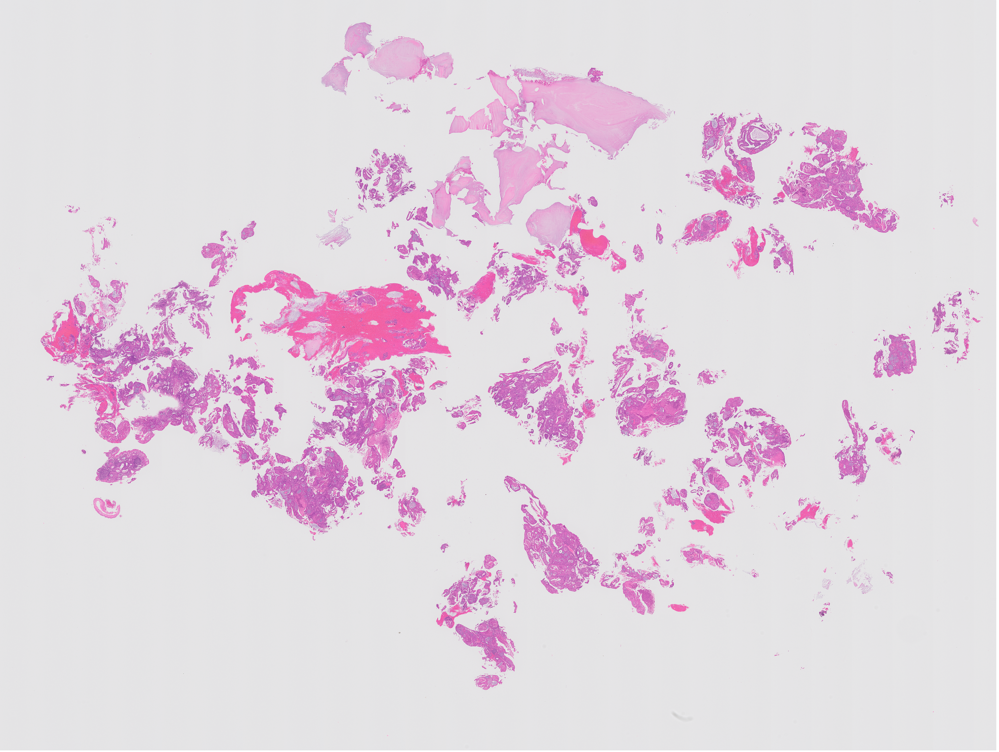

In [48]:
import numpy as np
from skimage import data, segmentation, feature, future
from sklearn.ensemble import RandomForestClassifier
from functools import partial

full_img = Image.open(test_dir / files[1])

full_img

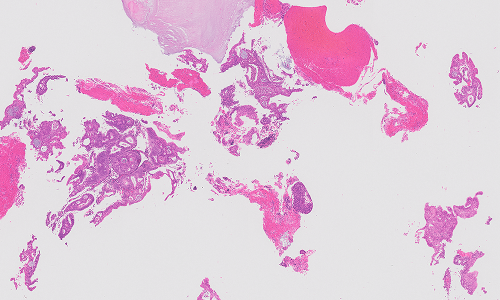

In [49]:
full_img_np = np.array(full_img)

img = full_img_np[700:1000, 1500:2000]

show_np(img)

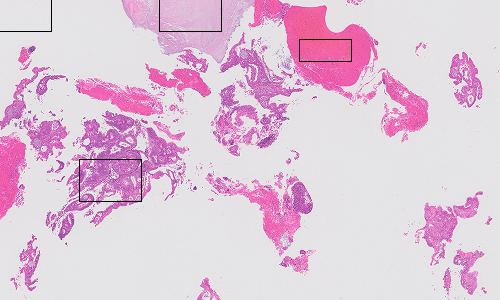

In [50]:
from skimage.draw import rectangle_perimeter

rr, cc = rectangle_perimeter((0, 160), end=(30,220), shape=img.shape)
img[rr, cc, :] = [0, 0, 0]

rr, cc = rectangle_perimeter((40, 300), end=(60,350), shape=img.shape)
img[rr, cc, :] = [0, 0, 0]

rr, cc = rectangle_perimeter((0, 0), end=(30,50), shape=img.shape)
img[rr, cc, :] = [0, 0, 0]

rr, cc = rectangle_perimeter((160, 80), end=(200, 140), shape=img.shape)
img[rr, cc, :] = [0, 0, 0]

show_np(img)

In [51]:
# Build an array of labels for training the segmentation.
# Here we use rectangles but visualization libraries such as plotly
# (and napari?) can be used to draw a mask on the image.
training_labels = np.zeros(img.shape[:2], dtype=np.uint8)
training_labels[0:30, 160:220] = 1
training_labels[40:60, 300:350] = 2
training_labels[0:30, 0:50] = 3
training_labels[160:200, 80:140] = 4


In [52]:
# multiscale basic features not in the version we have of scikit so copying in from github source

from itertools import combinations_with_replacement
import itertools
import numpy as np
from skimage import filters, feature
from skimage import img_as_float32
from concurrent.futures import ThreadPoolExecutor


def _texture_filter(gaussian_filtered):
    H_elems = [
        np.gradient(np.gradient(gaussian_filtered)[ax0], axis=ax1)
        for ax0, ax1 in combinations_with_replacement(range(gaussian_filtered.ndim), 2)
    ]
    eigvals = feature.hessian_matrix_eigvals(H_elems)
    return eigvals


def _singlescale_basic_features_singlechannel(
    img, sigma, intensity=True, edges=True, texture=True
):
    results = ()
    gaussian_filtered = filters.gaussian(img, sigma)
    if intensity:
        results += (gaussian_filtered,)
    if edges:
        results += (filters.sobel(gaussian_filtered),)
    if texture:
        results += (*_texture_filter(gaussian_filtered),)
    return results


def _mutiscale_basic_features_singlechannel(
    img,
    intensity=True,
    edges=True,
    texture=True,
    sigma_min=0.5,
    sigma_max=16,
    num_sigma=None,
    num_workers=None,
):
    """Features for a single channel nd image.
    Parameters
    ----------
    img : ndarray
        Input image, which can be grayscale or multichannel.
    intensity : bool, default True
        If True, pixel intensities averaged over the different scales
        are added to the feature set.
    edges : bool, default True
        If True, intensities of local gradients averaged over the different
        scales are added to the feature set.
    texture : bool, default True
        If True, eigenvalues of the Hessian matrix after Gaussian blurring
        at different scales are added to the feature set.
    sigma_min : float, optional
        Smallest value of the Gaussian kernel used to average local
        neighbourhoods before extracting features.
    sigma_max : float, optional
        Largest value of the Gaussian kernel used to average local
        neighbourhoods before extracting features.
    num_sigma : int, optional
        Number of values of the Gaussian kernel between sigma_min and sigma_max.
        If None, sigma_min multiplied by powers of 2 are used.
    num_workers : int or None, optional
        The number of parallel threads to use. If set to ``None``, the full
        set of available cores are used.
    Returns
    -------
    features : list
        List of features, each element of the list is an array of shape as img.
    """
    # computations are faster as float32
    img = np.ascontiguousarray(img_as_float32(img))
    if num_sigma is None:
        num_sigma = int(np.log2(sigma_max) - np.log2(sigma_min) + 1)
    sigmas = np.logspace(
        np.log2(sigma_min),
        np.log2(sigma_max),
        num=num_sigma,
        base=2,
        endpoint=True,
    )
    with ThreadPoolExecutor(max_workers=num_workers) as ex:
        out_sigmas = list(
            ex.map(
                lambda s: _singlescale_basic_features_singlechannel(
                    img, s, intensity=intensity, edges=edges, texture=texture
                ),
                sigmas,
            )
        )
    features = itertools.chain.from_iterable(out_sigmas)
    return features


def multiscale_basic_features(
    image,
    multichannel=False,
    intensity=True,
    edges=True,
    texture=True,
    sigma_min=0.5,
    sigma_max=16,
    num_sigma=None,
    num_workers=None,
):
    """Local features for a single- or multi-channel nd image.
    Intensity, gradient intensity and local structure are computed at
    different scales thanks to Gaussian blurring.
    Parameters
    ----------
    image : ndarray
        Input image, which can be grayscale or multichannel.
    multichannel : bool, default False
        True if the last dimension corresponds to color channels.
    intensity : bool, default True
        If True, pixel intensities averaged over the different scales
        are added to the feature set.
    edges : bool, default True
        If True, intensities of local gradients averaged over the different
        scales are added to the feature set.
    texture : bool, default True
        If True, eigenvalues of the Hessian matrix after Gaussian blurring
        at different scales are added to the feature set.
    sigma_min : float, optional
        Smallest value of the Gaussian kernel used to average local
        neighbourhoods before extracting features.
    sigma_max : float, optional
        Largest value of the Gaussian kernel used to average local
        neighbourhoods before extracting features.
    num_sigma : int, optional
        Number of values of the Gaussian kernel between sigma_min and sigma_max.
        If None, sigma_min multiplied by powers of 2 are used.
    num_workers : int or None, optional
        The number of parallel threads to use. If set to ``None``, the full
        set of available cores are used.
    Returns
    -------
    features : np.ndarray
        Array of shape ``image.shape + (n_features,)``
    """
    if not any([intensity, edges, texture]):
        raise ValueError(
                "At least one of ``intensity``, ``edges`` or ``textures``"
                "must be True for features to be computed."
                )
    if image.ndim < 3:
        multichannel = False
    if not multichannel:
        image = image[..., np.newaxis]
    all_results = (
        _mutiscale_basic_features_singlechannel(
            image[..., dim],
            intensity=intensity,
            edges=edges,
            texture=texture,
            sigma_min=sigma_min,
            sigma_max=sigma_max,
            num_sigma=num_sigma,
            num_workers=num_workers,
        )
        for dim in range(image.shape[-1])
    )
    features = list(itertools.chain.from_iterable(all_results))
    return np.stack(features, axis=-1)

In [53]:
# fit and predict segmenter also copied from scikit image v 18

def fit_segmenter(labels, features, clf):
    """Segmentation using labeled parts of the image and a classifier.
    Parameters
    ----------
    labels : ndarray of ints
        Image of labels. Labels >= 1 correspond to the training set and
        label 0 to unlabeled pixels to be segmented.
    features : ndarray
        Array of features, with the first dimension corresponding to the number
        of features, and the other dimensions correspond to ``labels.shape``.
    clf : classifier object
        classifier object, exposing a ``fit`` and a ``predict`` method as in
        scikit-learn's API, for example an instance of
        ``RandomForestClassifier`` or ``LogisticRegression`` classifier.
    Returns
    -------
    clf : classifier object
        classifier trained on ``labels``
    Raises
    ------
    NotFittedError if ``self.clf`` has not been fitted yet (use ``self.fit``).
    """
    mask = labels > 0
    training_data = features[mask]
    training_labels = labels[mask].ravel()
    clf.fit(training_data, training_labels)
    return clf

In [54]:
def predict_segmenter(features, clf):
    """Segmentation of images using a pretrained classifier.
    Parameters
    ----------
    features : ndarray
        Array of features, with the last dimension corresponding to the number
        of features, and the other dimensions are compatible with the shape of
        the image to segment, or a flattened image.
    clf : classifier object
        trained classifier object, exposing a ``predict`` method as in
        scikit-learn's API, for example an instance of
        ``RandomForestClassifier`` or ``LogisticRegression`` classifier. The
        classifier must be already trained, for example with
        :func:`skimage.segmentation.fit_segmenter`.
    Returns
    -------
    output : ndarray
        Labeled array, built from the prediction of the classifier.
    """
    sh = features.shape
    if features.ndim > 2:
        features = features.reshape((-1, sh[-1]))

    try:
        predicted_labels = clf.predict(features)
    except NotFittedError:
        raise NotFittedError(
            "You must train the classifier `clf` first"
            "for example with the `fit_segmenter` function."
        )
    except ValueError as err:
        if err.args and 'x must consist of vectors of length' in err.args[0]:
            raise ValueError(
                err.args[0] + '\n' +
                "Maybe you did not use the same type of features for training the classifier."
                )
    output = predicted_labels.reshape(sh[:-1])
    return output

In [55]:
sigma_min = 1
sigma_max = 16
features_func = partial(multiscale_basic_features,
                        intensity=True, edges=False, texture=True,
                        sigma_min=sigma_min, sigma_max=sigma_max,
                        multichannel=True)
features = features_func(img)


In [56]:
clf = RandomForestClassifier(n_estimators=50, n_jobs=-1,
                             max_depth=10, max_samples=0.05)
clf = fit_segmenter(training_labels, features, clf)


In [57]:
result = predict_segmenter(features, clf)


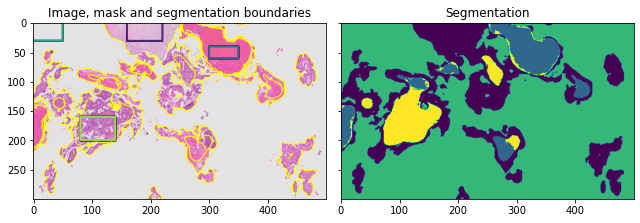

In [58]:
fig, ax = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(9, 4))
ax[0].imshow(segmentation.mark_boundaries(img, result, mode='thick'))
ax[0].contour(training_labels)
ax[0].set_title('Image, mask and segmentation boundaries')
ax[1].imshow(result)
ax[1].set_title('Segmentation')
fig.tight_layout()